In [ ]:
run_gridsearch = False
skip_best_model_validation = True
skip_best_model_test = True
verbose = False
cross_validation = True

GPU_SETTING = -1
NUM_ENSEMBLES = 5
BASIN = "warm_springs"
MODE = "hourly"
RUN_LABEL = "BASELINE"
READ_STAMP = "20250815T000000Z"

In [2]:
hyperparam_space = {
    "hidden_size": [64, 128, 256],
    "output_dropout": [0.4],
    "seq_length": [168, 336],
    "num_layers": [1],
    "epochs": [16, 32, 48],
    "batch_size": [64, 128, 256],
    "schedule_pairs": [
        ((0.5, 0.25), (0.01, 0.005, 0.001))
    ]
}

In [3]:
import sys
import pandas as pd
import os
import itertools
from pathlib import Path
from tqdm import tqdm
import warnings
from datetime import datetime
warnings.simplefilter(action='ignore', category=FutureWarning)

In [4]:
current_dir = os.getcwd()
print(current_dir)

/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/warm_springs


In [5]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-RR-PROJECT')
sys.path.insert(0, library_path)
print(sys.path)

['../../../../UCB-USACE-LSTMs', '/Users/canruso/Desktop/UCB-USACE-LSTMs/notebooks/basins/warm_springs', '/Users/canruso/Desktop', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python310.zip', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10/lib-dynload', '', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10/site-packages', '/Users/canruso/miniforge3/envs/ESDL_LSTM/lib/python3.10/site-packages/setuptools/_vendor']


In [6]:
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import (fractional_multi_lr, write_paths, to_path_or_list, ensure_output_tree, set_active_context, data_dir, repo_root, get_output_dir, make_run_stamp, get_yaml_path, ctx_for, hparams_exists, save_hparams, load_hparams, runs_latest_path, archive_runs_json, read_csv_artifact, ensure_shared_tree)
from UCB_training.UCB_plotting import (plot_timeseries_comparison, scatter_triptych_pngs_v3, ts_triptych_v3)

In [7]:
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-RR-PROJECT')[0] + 'UCB-USACE-RR-PROJECT'

In [8]:
RUNS_FILE = str(runs_latest_path(BASIN, MODE, RUN_LABEL))
SHOULD_STAMP = not (skip_best_model_validation and skip_best_model_test)
RUN_STAMP = make_run_stamp() if SHOULD_STAMP else None
ACTIVE_STAMP = RUN_STAMP if RUN_STAMP is not None else READ_STAMP

In [9]:
set_active_context(basin=BASIN, resolution=MODE, run_stamp=ACTIVE_STAMP, run_tag=RUN_LABEL, append_stamp_to_filenames=False)
SHARED_FOLDER = ensure_shared_tree(BASIN, MODE)
RUNS_PARENT = SHARED_FOLDER / "runs" / (f"{RUN_LABEL}_{RUN_STAMP}" if RUN_STAMP else RUN_LABEL)

print("NH runs will be written under:")
print(RUNS_PARENT.resolve())

NH runs will be written under:
/Users/canruso/Desktop/UCB-USACE-LSTMs/outputs/warm_springs/hourly_shared/runs/BASELINE


In [10]:
path_to_csv = data_dir()
path_to_yaml = get_yaml_path("warm_springs_dam_nlayer")
path_to_physics_data = path_to_csv / "WarmSprings_Inflow_hourly.csv"

In [11]:
features_with_physics = [
    #from daily.csv
    "DRY CREEK 20 PRECIP-INC SCREENED",
    "DRY CREEK 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "DRY CREEK 30 PRECIP-INC SCREENED",
    "DRY CREEK 30 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "SANTA ROSA CA HUMIDITY USAF-NOAA",
    "SANTA ROSA CA SOLAR RADIATION USAF-NOAA",
    "SANTA ROSA CA TEMPERATURE USAF-NOAA",
    "SANTA ROSA CA WINDSPEED USAF-NOAA",
    #from Warm_Spring_Inflow.csv
    'Dry Creek 20 ET-POTENTIAL',
    'Dry Creek 20 FLOW',
    'Dry Creek 20 FLOW-BASE',
    'Dry Creek 20 INFILTRATION',
    'Dry Creek 20 PERC-SOIL',
    'Dry Creek 20 SATURATION FRACTION',
    'Dry Creek 30 ET-POTENTIAL',
    'Dry Creek 30 FLOW',
    'Dry Creek 30 FLOW-BASE',
    'Dry Creek 30 INFILTRATION',
    'Dry Creek 30 PERC-SOIL',
    'Dry Creek 30 SATURATION FRACTION',
    'Warm Springs Dam Inflow FLOW',
]

In [12]:
no_physics_results = []
physics_results = []

In [13]:
start_time = datetime.utcnow()
print("Start time:", start_time.strftime("%Y-%m-%d %H:%M:%S"))

Start time: 2025-08-19 17:43:37


In [ ]:
hyperparam_names = []
for i, hp in enumerate(hyperparam_space.keys()):
    hyperparam_names.append(hp)

total_iters = 1
for name in hyperparam_names:
    total_iters *= len(hyperparam_space[name])

if run_gridsearch or not hparams_exists(BASIN, MODE, RUN_LABEL):
    for combinations in tqdm(
        itertools.product(*[hyperparam_space[hp] for hp in hyperparam_names]), 
        desc="Grid-Search", 
        total=total_iters, 
        unit="it", 
        ncols=60, 
        ascii=True):

        hp_run = {}
        j = 0
        schedule_pairs = None
        
        while j < len(hyperparam_names):
            name = hyperparam_names[j]
            val = combinations[j]

            if name == "seq_length":
                hp_run["seq_length"] = val
    
            elif name == "schedule_pairs":
                schedule_pairs = val
            else:
                hp_run[name] = val
    
            j += 1

        if schedule_pairs is not None:
            fractions, rates = schedule_pairs
            hp_run["learning_rate"] = fractional_multi_lr(
                epochs=int(hp_run["epochs"]), fractions=list(fractions), lrs=list(rates))
        else:
            hp_run.setdefault("learning_rate", {0: 0.01, 30: 0.005, 40: 0.001})

        if verbose:
            print(f"\nNoPhysics: {hp_run}")
            
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp_run,
            input_features=None,
            physics_informed=False,
            physics_data_file=None,
            hourly=True,  
            extend_train_period=False,
            gpu=GPU_SETTING,
            verbose=verbose,
            runs_parent=RUNS_PARENT,
            run_label=RUN_LABEL,
            run_stamp=RUN_STAMP)
        
        if not cross_validation:
            trainer.train()
            csv_path, metrics_dict = trainer.results()
        else:
            metrics_dict = trainer.cross_validate(run_path=RUNS_PARENT)
        
        row_data = {}
        j = 0
        while j < len(hyperparam_names):
            row_data[hyperparam_names[j]] = combinations[j]
            j += 1
            
        row_data["learning_rate"] = str(hp_run["learning_rate"])
            
        for k, v in metrics_dict.items():
            row_data[k] = v
        
        no_physics_results.append(row_data)

    df_no_physics = pd.DataFrame(no_physics_results)
    if cross_validation:
        df_no_physics.sort_values(by="avg NSE", ascending=False, inplace=True)
    else:
        df_no_physics.sort_values(by="NSE", ascending=False, inplace=True)
    df_no_physics.reset_index(drop=True, inplace=True)
else:
    print("Skipping grid search!")

Skipping grid search!


In [ ]:
if run_gridsearch or not hparams_exists(BASIN, MODE, RUN_LABEL):    
    for combinations in tqdm(
        itertools.product(*[hyperparam_space[hp] for hp in hyperparam_names]), 
        desc="Grid-Search", 
        total=total_iters, 
        unit="it", 
        ncols=60, 
        ascii=True):

        hp_run = {}
        j = 0
        schedule_pairs = None

        while j < len(hyperparam_names):
            name = hyperparam_names[j]
            val  = combinations[j]

            if name == "seq_length":
                hp_run["seq_length"] = val

            elif name == "schedule_pairs":
                schedule_pairs = val

            else:
                hp_run[name] = val

            j += 1

        if schedule_pairs is not None:
            fractions, rates = schedule_pairs
            hp_run["learning_rate"] = fractional_multi_lr(
                epochs=int(hp_run["epochs"]), fractions=list(fractions), lrs=list(rates))
        else:
            hp_run.setdefault("learning_rate", {0: 0.01, 30: 0.005, 40: 0.001})
            
        if verbose:
            print(f"\nPhysics: {hp_run}")
            
        trainer = UCB_trainer(
            path_to_csv_folder=path_to_csv,
            yaml_path=path_to_yaml,
            hyperparams=hp_run,
            input_features=features_with_physics,
            physics_informed=True,
            physics_data_file=path_to_physics_data,
            hourly=True,
            extend_train_period=False,
            gpu=GPU_SETTING,
            verbose=verbose,
            runs_parent=RUNS_PARENT,
            run_label=RUN_LABEL,
            run_stamp=RUN_STAMP)
        
        if not cross_validation:
            trainer.train()
            csv_path, metrics_dict = trainer.results()
        else:
            metrics_dict = trainer.cross_validate(run_path=RUNS_PARENT)

        row_data = {}
        j = 0
        while j < len(hyperparam_names):
            row_data[hyperparam_names[j]] = combinations[j]
            j += 1
            
        row_data["learning_rate"] = str(hp_run["learning_rate"])

        for k, v in metrics_dict.items():
            row_data[k] = v
            
        physics_results.append(row_data)
    df_physics = pd.DataFrame(physics_results)
    if cross_validation:
        df_physics.sort_values(by="avg NSE", ascending=False, inplace=True)
    else:
        df_physics.sort_values(by="NSE", ascending=False, inplace=True)
    df_physics.reset_index(drop=True, inplace=True)
    best_no_phys = df_no_physics.iloc[0].to_dict()
    best_phys = df_physics.iloc[0].to_dict()
    best_no_phys["model_type"] = "no_physics"
    best_phys["model_type"] = "physics"
    best_params_df = pd.DataFrame([best_no_phys, best_phys])
    save_hparams(best_df=best_params_df, basin=BASIN, mode=MODE, label=RUN_LABEL, run_stamp=RUN_STAMP, df_no=df_no_physics, df_phys=df_physics)
else:
    print("Skipping grid search!")

Skipping grid search!


In [16]:
try:
    if run_gridsearch:
        print("\n[INFO] Using best_params_df from the just-completed grid search (ignoring READ_STAMP).")
    else:
        print("\nLoading best hyperparams from CSV...")
        best_params_df = load_hparams(BASIN, MODE, RUN_LABEL, stamp=READ_STAMP)
except FileNotFoundError as e:
    raise SystemExit(f"[ERROR] {e}  (Set run_gridsearch=True to generate it.)")

best_no_phys = best_params_df.query("model_type == 'no_physics'").iloc[0].to_dict()
best_phys = best_params_df.query("model_type == 'physics'").iloc[0].to_dict()

best_no_physics_params = {}
j = 0
while j < len(hyperparam_names):
    name = hyperparam_names[j]
    if name == "output_dropout":
        best_no_physics_params[name] = float(best_no_phys[name])
        j += 1

    elif name == "seq_length":
        best_no_physics_params["seq_length"] = int(best_no_phys["seq_length"])
        j += 1

    elif name == "schedule_pairs":
        j += 1

    else:
        best_no_physics_params[name] = int(best_no_phys[name])
        j += 1

if "learning_rate" in best_no_phys and pd.notna(best_no_phys["learning_rate"]):
    best_no_physics_params["learning_rate"] = eval(str(best_no_phys["learning_rate"]))

elif "schedule_pairs" in best_no_phys and pd.notna(best_no_phys["schedule_pairs"]):
    sp = best_no_phys["schedule_pairs"]
    if isinstance(sp, str):
        sp = eval(sp)
    fractions, rates = sp
    best_no_physics_params["learning_rate"] = fractional_multi_lr(
        epochs=int(best_no_physics_params["epochs"]),
        fractions=list(fractions),
        lrs=list(rates))

else:
    best_no_physics_params["learning_rate"] = {0: 0.01, 30: 0.005, 40: 0.001}

best_physics_params = {}
j = 0
while j < len(hyperparam_names):
    name = hyperparam_names[j]
    if name == "output_dropout":
        best_physics_params[name] = float(best_phys[name])
        j += 1

    elif name == "seq_length":
        best_physics_params["seq_length"] = int(best_phys["seq_length"])
        j += 1

    elif name == "schedule_pairs":
        j += 1

    else:
        best_physics_params[name] = int(best_phys[name])
        j += 1

if "learning_rate" in best_phys and pd.notna(best_phys["learning_rate"]):
    best_physics_params["learning_rate"] = eval(str(best_phys["learning_rate"]))

elif "schedule_pairs" in best_phys and pd.notna(best_phys["schedule_pairs"]):
    sp = best_phys["schedule_pairs"]
    if isinstance(sp, str):
        sp = eval(sp)
    fractions, rates = sp
    best_physics_params["learning_rate"] = fractional_multi_lr(
        epochs=int(best_physics_params["epochs"]),
        fractions=list(fractions),
        lrs=list(rates))

else:
    best_physics_params["learning_rate"] = {0: 0.01, 30: 0.005, 40: 0.001}

print("Loaded best hyperparams from CSV:")
print("Best NO-PHYS:", best_no_physics_params)
print("Best PHYS:", best_physics_params)

Loaded best hyperparams from CSV:
Best NO-PHYS: {'hidden_size': 256, 'seq_length': 168, 'num_layers': 1, 'epochs': 48, 'batch_size': 256}
Best PHYS: {'hidden_size': 64, 'seq_length': 336, 'num_layers': 1, 'epochs': 32, 'batch_size': 64}


### Re-run validation with best hyperparameters

In [17]:
if not skip_best_model_validation:
    lstmNoPhysicsValBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=False,
        gpu=GPU_SETTING,
        # num_ensemble_members = NUM_ENSEMBLES,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    lstmNoPhysicsValBest.train()
    no_physics_val_csv, no_physics_val_metrics = lstmNoPhysicsValBest.results()
    no_physics_val_metrics

In [18]:
if not skip_best_model_validation:
    lstmPhysicsValBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data,
        hourly=True,
        extend_train_period=False,
        gpu=GPU_SETTING,
        # num_ensemble_members = NUM_ENSEMBLES,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    lstmPhysicsValBest.train()
    physics_val_csv, physics_val_metrics = lstmPhysicsValBest.results()
    physics_val_metrics

HMS
  NSE = 0.588
  PBIAS = -8.728
LSTM
  NSE = 0.715
  PBIAS = -21.686
PILSTM
  NSE = 0.796
  PBIAS = -15.058


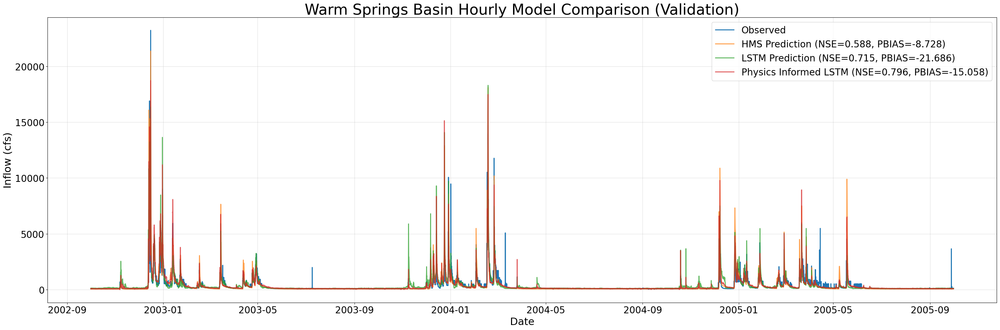

In [19]:
if not skip_best_model_validation:
    plot_timeseries_comparison(source=(no_physics_val_csv, physics_val_csv, path_to_physics_data), title="Warm Springs Basin Hourly Model Comparison (Validation)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="warm_springs_hourly_val_metrics.csv", ts_out="warm_springs_hourly_val_combined_ts.csv", fig_out="warm_springs_hourly_val_model_comparison.png", legend_font=20, axis_font=22)
else:
    combined_df_val = read_csv_artifact("warm_springs_hourly_val_combined_ts.csv", kind="csv", period="validation", stamp = READ_STAMP, run_label = RUN_LABEL)
    plot_timeseries_comparison(source=combined_df_val, title="Warm Springs Basin Hourly Model Comparison (Validation)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="warm_springs_hourly_val_metrics.csv", ts_out="warm_springs_hourly_val_combined_ts.csv", fig_out="warm_springs_hourly_val_model_comparison.png", legend_font=20, axis_font=22)

In [20]:
if skip_best_model_validation:
    val_metrics = read_csv_artifact("warm_springs_hourly_val_metrics.csv", kind="metrics", period="validation", index_col=0, stamp = READ_STAMP, run_label = RUN_LABEL)
    print(val_metrics)

                       HMS           LSTM         PILSTM
NSE               0.587694       0.715161       0.796440
MSE          261645.511099  180755.856685  129177.043850
RMSE            511.512963     425.153921     359.412081
KGE               0.646060       0.708965       0.765998
Alpha-NSE         1.322810       1.161221       1.162896
Beta-KGE          1.087275       1.216862       1.150577
Beta-NSE          0.035665       0.088620       0.061533
Pearson-r         0.884024       0.891927       0.925514
FHV              35.450486      20.224553      20.028986
FMS              12.396291     -23.939078      -8.991169
FLV              75.845919      19.143763   -2827.748762
Peak-Timing            NaN            NaN            NaN
Peak-MAPE        44.144904      55.995987      39.781135
PBIAS            -8.727518     -21.686241     -15.057732


### Re-run test with best hyperparameters

In [21]:
if not skip_best_model_test:
    lstmNoPhysicsExtBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_no_physics_params,
        input_features=None,
        physics_informed=False,
        physics_data_file=None,
        hourly=True,
        extend_train_period=True,  
        gpu=GPU_SETTING,
        # num_ensemble_members = NUM_ENSEMBLES,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    lstmNoPhysicsExtBest.train()
    no_physics_test_csv, no_physics_test_metrics = lstmNoPhysicsExtBest.results('test')
    no_physics_test_metrics

In [22]:
if not skip_best_model_test:
    lstmPhysicsExtBest = UCB_trainer(
        path_to_csv_folder=path_to_csv,
        yaml_path=path_to_yaml,
        hyperparams=best_physics_params,
        input_features=features_with_physics,
        physics_informed=True,
        physics_data_file=path_to_physics_data,
        hourly=True,
        extend_train_period=True,
        gpu=GPU_SETTING,
        # num_ensemble_members = NUM_ENSEMBLES,
        verbose=verbose,
        runs_parent=RUNS_PARENT,
        run_label=RUN_LABEL,
        run_stamp=RUN_STAMP)
    
    lstmPhysicsExtBest.train()
    physics_test_csv, physics_test_metrics = lstmPhysicsExtBest.results('test')
    physics_test_metrics

HMS
  NSE = 0.614
  PBIAS = -3.816
LSTM
  NSE = 0.711
  PBIAS = 0.448
PILSTM
  NSE = 0.784
  PBIAS = -4.282


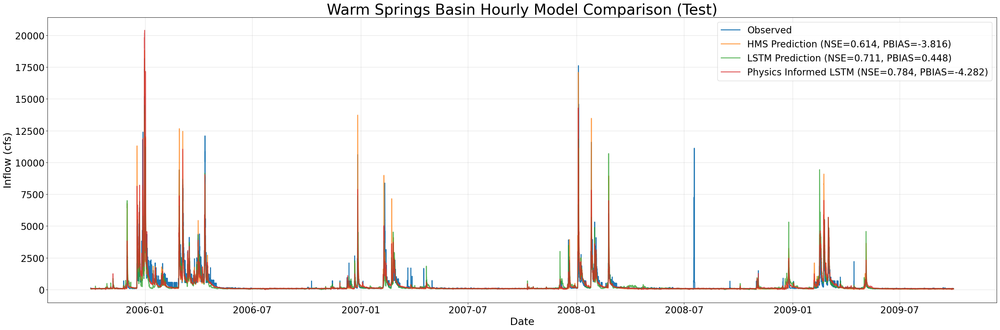

In [23]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Basin Hourly Model Comparison (Test)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_model_comparison.png", legend_font=20, axis_font=22)
else:
    combined_df = read_csv_artifact("warm_springs_hourly_test_combined_ts.csv", kind="csv", period="test", stamp = READ_STAMP, run_label = RUN_LABEL)
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Basin Hourly Model Comparison (Test)", backend="mpl", metrics=["NSE", "PBIAS"], metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_model_comparison.png", legend_font=20, axis_font=22)

In [24]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Basin Hourly Model Comparison (Test)", backend="plotly", metrics=["NSE", "PBIAS"], metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Basin Hourly Model Comparison (Test)", backend="plotly", metrics=["NSE", "PBIAS"], metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.614
  PBIAS = -3.816
LSTM
  NSE = 0.711
  PBIAS = 0.448
PILSTM
  NSE = 0.784
  PBIAS = -4.282


In [25]:
test_metrics = read_csv_artifact("warm_springs_hourly_test_metrics.csv", kind="metrics", period="test", index_col=0, stamp = READ_STAMP, run_label = RUN_LABEL)
print(test_metrics)

                       HMS           LSTM         PILSTM
NSE               0.613711       0.710783       0.784139
MSE          259714.682566  194449.646295  145130.457206
RMSE            509.622098     440.964450     380.959915
KGE               0.760494       0.819044       0.873157
Alpha-NSE         1.183732       0.906257       1.066783
Beta-KGE          1.038161       0.995518       1.042824
Beta-NSE          0.013852      -0.001627       0.015545
Pearson-r         0.851174       0.845283       0.901030
FHV              25.384241      -3.192229       8.780880
FMS              30.904678      19.359148       9.290381
FLV              79.780767   -2241.089847   -2250.025002
Peak-Timing            NaN            NaN            NaN
Peak-MAPE        55.160802      54.835295      44.103571
PBIAS            -3.816074       0.448165      -4.282449


In [26]:
if not skip_best_model_test:
    write_paths("no_physics", lstmNoPhysicsExtBest, filename=RUNS_FILE)
    write_paths("physics", lstmPhysicsExtBest, filename=RUNS_FILE)
    archived_path = archive_runs_json(Path(RUNS_FILE), BASIN, MODE, RUN_LABEL, RUN_STAMP)

In [27]:
end_time = datetime.utcnow()
print("\nEnd time:", end_time.strftime("%Y-%m-%d %H:%M:%S"))
print("Total time:", end_time - start_time)


End time: 2025-08-19 17:43:51
Total time: 0:00:14.756969


##### Additional Plots

In [28]:
if skip_best_model_validation:
    combined_df_val = read_csv_artifact("warm_springs_hourly_val_combined_ts.csv", kind="csv", period="validation", stamp = READ_STAMP, run_label = RUN_LABEL)
if skip_best_model_test:
    combined_df = read_csv_artifact("warm_springs_hourly_test_combined_ts.csv", kind="csv", period="test", stamp = READ_STAMP, run_label = RUN_LABEL)

In [29]:
metric_list = ["NSE", "PBIAS"]

wettest_start_val = "2003-10-01"
wettest_end_val = "2004-09-30"
dryest_start_val = "2004-10-01"
dryest_end_val = "2005-09-30"
wettest_start_test = "2005-10-01"
wettest_end_test = "2006-09-30"
dryest_start_test = "2008-10-01"
dryest_end_test = "2009-09-30"

HMS
  NSE = 0.588
  PBIAS = -8.728
LSTM
  NSE = 0.715
  PBIAS = -21.686
PILSTM
  NSE = 0.796
  PBIAS = -15.058


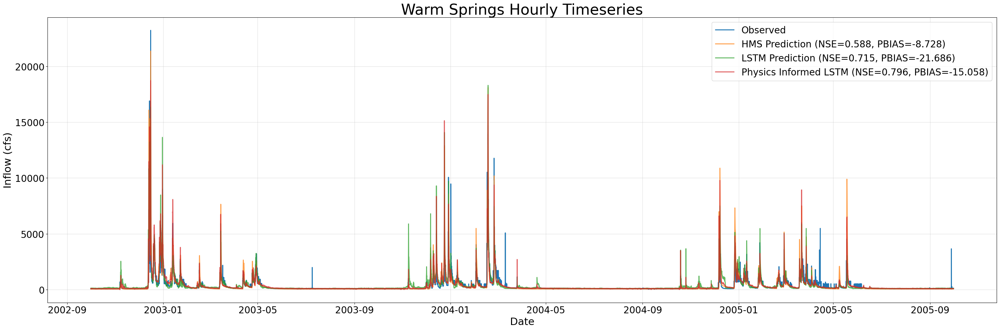

In [30]:
if not skip_best_model_validation:
    plot_timeseries_comparison(source=(no_physics_val_csv, physics_val_csv, path_to_physics_data), title="Warm Springs Hourly Validation Timeseries", backend="mpl", metrics=metric_list, metrics_out="warm_springs_hourly_val_metrics.csv", ts_out="warm_springs_hourly_val_combined_ts.csv", fig_out="warm_springs_hourly_val_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_val, title="Warm Springs Hourly Timeseries", backend="mpl", metrics=metric_list, metrics_out="warm_springs_hourly_val_metrics.csv", ts_out="warm_springs_hourly_val_combined_ts.csv", fig_out="warm_springs_hourly_val_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.614
  PBIAS = -3.816
LSTM
  NSE = 0.711
  PBIAS = 0.448
PILSTM
  NSE = 0.784
  PBIAS = -4.282


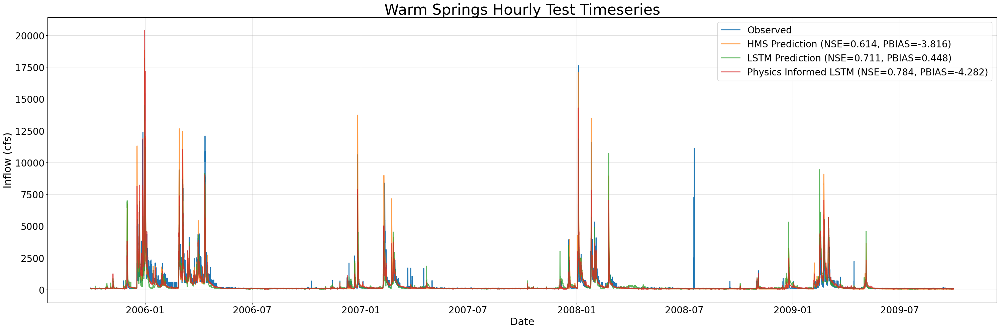

In [31]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Hourly Test Timeseries", backend="mpl", metrics=metric_list, metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_test_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Hourly Test Timeseries", backend="mpl", metrics=metric_list, metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_test_model_comparison.png", legend_font=20, axis_font=22)

In [32]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Hourly Test Timeseries", backend="plotly", metrics=metric_list, metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_test_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Hourly Test Timeseries", backend="plotly", metrics=metric_list, metrics_out="warm_springs_hourly_test_metrics.csv", ts_out="warm_springs_hourly_test_combined_ts.csv", fig_out="warm_springs_hourly_test_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.614
  PBIAS = -3.816
LSTM
  NSE = 0.711
  PBIAS = 0.448
PILSTM
  NSE = 0.784
  PBIAS = -4.282


##### Wettest Year Performance

HMS
  NSE = 0.694
  PBIAS = -1.546
LSTM
  NSE = 0.688
  PBIAS = -27.741
PILSTM
  NSE = 0.777
  PBIAS = -8.125


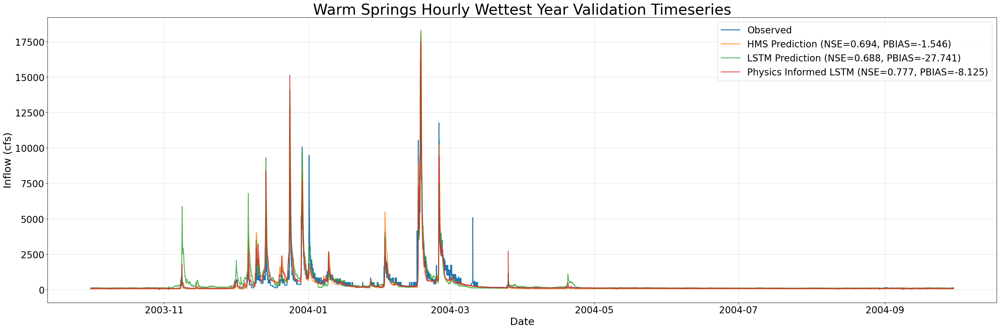

In [33]:
if not skip_best_model_validation:
    plot_timeseries_comparison(source=(no_physics_val_csv, physics_val_csv, path_to_physics_data), title="Warm Springs Hourly Wettest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_val, end_date=wettest_end_val, metrics_out="warm_springs_hourly_val_wet_metrics.csv", ts_out="warm_springs_hourly_val_wet_combined_ts.csv", fig_out="warm_springs_hourly_val_wet_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_val, title="Warm Springs Hourly Wettest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_val, end_date=wettest_end_val, metrics_out="warm_springs_hourly_val_wet_metrics.csv", ts_out="warm_springs_hourly_val_wet_combined_ts.csv", fig_out="warm_springs_hourly_val_wet_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = 0.795
  PBIAS = 7.777
LSTM
  NSE = 0.813
  PBIAS = 21.237
PILSTM
  NSE = 0.884
  PBIAS = 5.216


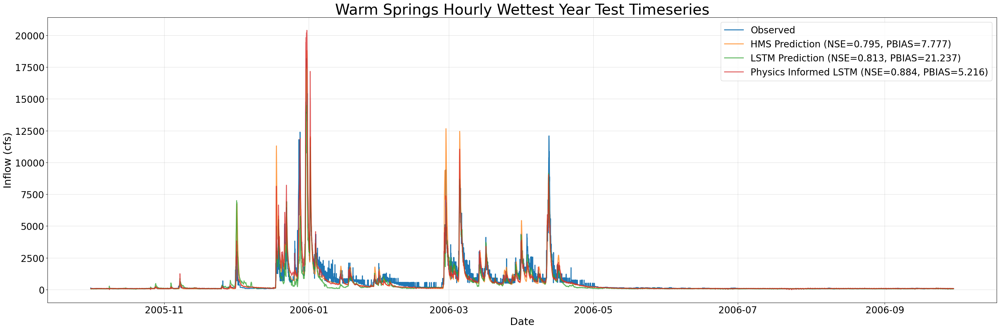

In [34]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Hourly Wettest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="warm_springs_hourly_test_wet_metrics.csv", ts_out="warm_springs_hourly_test_wet_combined_ts.csv", fig_out="warm_springs_hourly_test_wet_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Hourly Wettest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="warm_springs_hourly_test_wet_metrics.csv", ts_out="warm_springs_hourly_test_wet_combined_ts.csv", fig_out="warm_springs_hourly_test_wet_model_comparison.png", legend_font=20, axis_font=22)

In [35]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Hourly Wettest Year Test Timeseries", backend="plotly", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="warm_springs_hourly_test_wet_metrics.csv", ts_out="warm_springs_hourly_test_wet_combined_ts.csv", fig_out="warm_springs_hourly_test_wet_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Hourly Wettest Year Test Timeseries", backend="plotly", metrics=metric_list, start_date=wettest_start_test, end_date=wettest_end_test, metrics_out="warm_springs_hourly_test_wet_metrics.csv", ts_out="warm_springs_hourly_test_wet_combined_ts.csv", fig_out="warm_springs_hourly_test_wet_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = 0.795
  PBIAS = 7.777
LSTM
  NSE = 0.813
  PBIAS = 21.237
PILSTM
  NSE = 0.884
  PBIAS = 5.216


##### Dryest Year Performance

HMS
  NSE = -0.032
  PBIAS = -13.187
LSTM
  NSE = 0.505
  PBIAS = -18.179
PILSTM
  NSE = 0.679
  PBIAS = -13.600


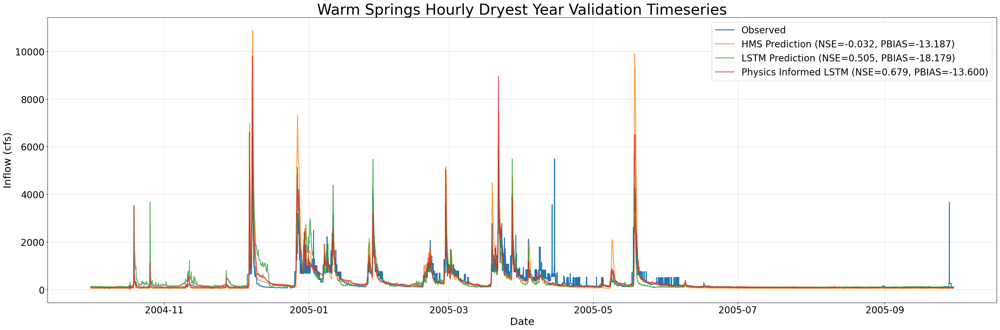

In [36]:
if not skip_best_model_validation:
    plot_timeseries_comparison(source=(no_physics_val_csv, physics_val_csv, path_to_physics_data), title="Warm Springs Hourly Dryest Year Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_val, end_date=dryest_end_val, metrics_out="warm_springs_hourly_val_dry_metrics.csv", ts_out="warm_springs_hourly_val_dry_combined_ts.csv", fig_out="warm_springs_hourly_val_dry_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df_val, title="Warm Springs Hourly Dryest Year Validation Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_val, end_date=dryest_end_val, metrics_out="warm_springs_hourly_val_dry_metrics.csv", ts_out="warm_springs_hourly_val_dry_combined_ts.csv", fig_out="warm_springs_hourly_val_dry_model_comparison.png", legend_font=20, axis_font=22)

HMS
  NSE = -0.312
  PBIAS = -33.810
LSTM
  NSE = -0.353
  PBIAS = -54.265
PILSTM
  NSE = 0.292
  PBIAS = -44.735


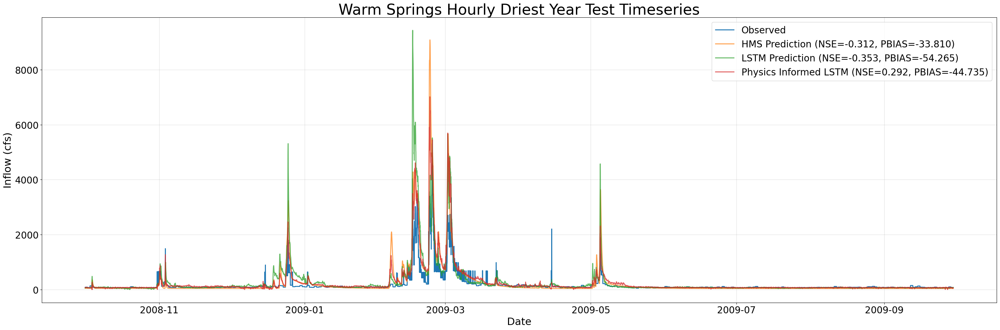

In [37]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Hourly Driest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="warm_springs_hourly_test_dry_metrics.csv", ts_out="warm_springs_hourly_test_dry_combined_ts.csv", fig_out="warm_springs_hourly_test_dry_model_comparison.png", legend_font=20, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Hourly Driest Year Test Timeseries", backend="mpl", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="warm_springs_hourly_test_dry_metrics.csv", ts_out="warm_springs_hourly_test_dry_combined_ts.csv", fig_out="warm_springs_hourly_test_dry_model_comparison.png", legend_font=20, axis_font=22)

In [38]:
if not skip_best_model_test:
    plot_timeseries_comparison(source=(no_physics_test_csv, physics_test_csv, path_to_physics_data), title="Warm Springs Hourly Driest Year Test Timeseries", backend="plotly", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="warm_springs_hourly_test_dry_metrics.csv", ts_out="warm_springs_hourly_test_dry_combined_ts.csv", fig_out="warm_springs_hourly_test_dry_model_comparison.png", legend_font=12, axis_font=22)
else:
    plot_timeseries_comparison(source=combined_df, title="Warm Springs Hourly Driest Year Test Timeseries", backend="plotly", metrics=metric_list, start_date=dryest_start_test, end_date=dryest_end_test, metrics_out="warm_springs_hourly_test_dry_metrics.csv", ts_out="warm_springs_hourly_test_dry_combined_ts.csv", fig_out="warm_springs_hourly_test_dry_model_comparison.png", legend_font=12, axis_font=22)

HMS
  NSE = -0.312
  PBIAS = -33.810
LSTM
  NSE = -0.353
  PBIAS = -54.265
PILSTM
  NSE = 0.292
  PBIAS = -44.735


##### Gridded Timeseries Plots - Validation and Test

In [39]:
if not skip_best_model_validation:
    ts_triptych_v3((no_physics_val_csv, physics_val_csv, path_to_physics_data),wet_start=wettest_start_val, wet_end=wettest_end_val, dry_start=dryest_start_val, dry_end=dryest_end_val, save_path="warm_springs_hourly_TS_validation.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d-%b-%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title="Warm Springs Hourly Validation Period Timeseries Across Models", main_title_font=14, main_title_y=0.99, main_title_pad=0.05, row_titles=("Full Validation period","Most-wet water-year","Most-dry water-year"))

else:
    ts_triptych_v3(combined_df_val, wet_start=wettest_start_val, wet_end=wettest_end_val, dry_start=dryest_start_val, dry_end=dryest_end_val, save_path="warm_springs_hourly_TS_validation.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d‑%b‑%Y", figsize=(10, 10), dpi=600, hspace=0.2, main_title = "Warm Springs Hourly Validation Timeseries Across Models", main_title_font=14, main_title_y = 0.99, main_title_pad = 0.05, row_titles=("Full validation period", "Most‑wet water‑year", "Most‑dry water‑year"))

In [40]:
if not skip_best_model_test:
    ts_triptych_v3((no_physics_test_csv, physics_test_csv, path_to_physics_data), wet_start=wettest_start_test, wet_end=wettest_end_test, dry_start=dryest_start_test, dry_end=dryest_end_test,
    save_path="warm_springs_hourly_TS_test.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d-%b-%Y", figsize=(10, 10), dpi=600,
    hspace=0.2, main_title="Warm Springs Hourly Test Period Timeseries Across Models", main_title_font=14, main_title_y=0.99, main_title_pad=0.05, row_titles=("Full test period", "Most-wet water-year", "Most-dry water-year"))

else:
    ts_triptych_v3(combined_df, wet_start=wettest_start_test, wet_end=wettest_end_test, dry_start=dryest_start_test, dry_end=dryest_end_test,
    save_path="warm_springs_hourly_TS_test.png", legend_font=12, legend_boxpad=0.5, axis_font=12, date_fmt="%d‑%b‑%Y", figsize=(10, 10), dpi=600,
    hspace=0.2, main_title = "Warm Springs Hourly Test Timeseries Across Models", main_title_font=14, main_title_y = 0.99, main_title_pad = 0.05, row_titles=("Full test period", "Most‑wet water‑year", "Most‑dry water‑year"))

##### Gridded Scatter Plots - Test

In [41]:
if not skip_best_model_test:
    scatter_pngs = scatter_triptych_pngs_v3((no_physics_test_csv, physics_test_csv, path_to_physics_data), wet_start = wettest_start_test, wet_end = wettest_end_test, dry_start = dryest_start_test,  dry_end = dryest_end_test, out_dir = "warm_springs_hourly_scatter", layout = "horizontal", square_side  = 4.5,legend_font = 16, axis_font = 16, point_size = 28, top_pad = .90, suptitle_y = 1.04, dpi = 600, row_titles = ("Warm Springs Hourly – Full test period", "Warm Springs Hourly – Wettest water‑year", "Warm Springs Hourly – Driest water‑year"), resolution="hourly")

else:
    scatter_pngs = scatter_triptych_pngs_v3(combined_df, wet_start = wettest_start_test, wet_end = wettest_end_test, dry_start = dryest_start_test,  dry_end = dryest_end_test, out_dir = "warm_springs_hourly_scatter", layout = "horizontal", square_side  = 4.5,legend_font = 16, axis_font = 16, point_size = 28, top_pad = .90, suptitle_y = 1.04, dpi = 600, row_titles = ("Warm Springs Hourly – Full test period", "Warm Springs Hourly – Wettest water‑year", "Warm Springs Hourly – Driest water‑year"), resolution="hourly")